In [1]:
pwd

'/Users/apple/.Trash/PERSONAL/companies/Adidas'

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [5]:
train=pd.read_excel('/Users/apple/Downloads/train_file.xlsx')
test=pd.read_excel('/Users/apple/Downloads/test_file.xlsx')

In [6]:
train.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,previous,poutcome,y
0,49,blue-collar,married,basic.9y,unknown,no,no,cellular,nov,wed,227,4,0,nonexistent,no
1,37,entrepreneur,married,university.degree,no,no,no,telephone,nov,wed,202,2,1,failure,no
2,78,retired,married,basic.4y,no,no,no,cellular,jul,mon,1148,1,0,nonexistent,yes
3,36,admin.,married,university.degree,no,yes,no,telephone,may,mon,120,2,0,nonexistent,no
4,59,retired,divorced,university.degree,no,no,no,cellular,jun,tue,368,2,0,nonexistent,no


In [7]:
train.describe()

,age,duration,campaign,previous
count,32910.000000,32910.000000,32910.000000,32910.000000
mean,40.014099,258.164327,2.560620,0.174810
std,10.402948,259.070260,2.753336,0.499211
min,17.000000,0.000000,1.000000,0.000000
25%,32.000000,103.000000,1.000000,0.000000
50%,38.000000,180.000000,2.000000,0.000000
75%,47.000000,319.000000,3.000000,0.000000
max,98.000000,4918.000000,56.000000,7.000000


In [8]:

def basic_eda( merged_df):
    plot_df=pd.DataFrame()
    for c in merged_df.columns:
        row= pd.DataFrame({'column':[c], 'dtype':[merged_df[c].dtype],'unique_values': [len(merged_df[c].unique())],
            'null_values':[merged_df[c].isnull().sum(), ]})
        # print(row)
        plot_df=pd.concat([plot_df,row], ignore_index=True)
    return(plot_df)


In [10]:
eda_data=basic_eda(train)
eda_data.style.background_gradient()

,column,dtype,unique_values,null_values
0,age,int64,75,0
1,job,object,12,0
2,marital,object,4,0
3,education,object,8,0
4,default,object,3,0
5,housing,object,3,0
6,loan,object,3,0
7,contact,object,2,0
8,month,object,10,0
9,day_of_week,object,5,0


In [37]:
12*4*8*3*3*3*2*18*5*3

5598720

### cardinality in data= 12*4*8....*3= 5598720
observation - bayesian, embedding layer would require cause of high cardinality

In [70]:
eda_data=basic_eda(test)
eda_data.style.background_gradient()

,column,dtype,unique_values,null_values
0,age,int64,23,0
1,job,object,10,0
2,marital,object,3,0
3,education,object,6,0
4,default,object,2,0
5,housing,object,3,0
6,loan,object,3,0
7,contact,object,2,0
8,month,object,6,0
9,day_of_week,object,5,0


In [11]:
# analysing both the categories seperately
train_no=train[train['y'] == 'no']
train_yes=train[train['y'] == 'yes']

In [12]:
print(len(train_no), len(train_yes))

29203 3707


### observation 2- may require over-sampling

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe57eb9a5d0>,
      dtype=object)

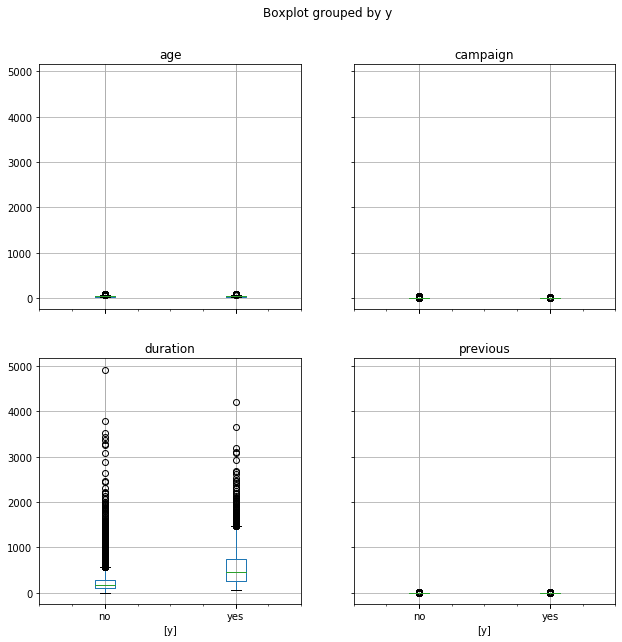

In [13]:
train.boxplot(by='y', figsize= (10,10))

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


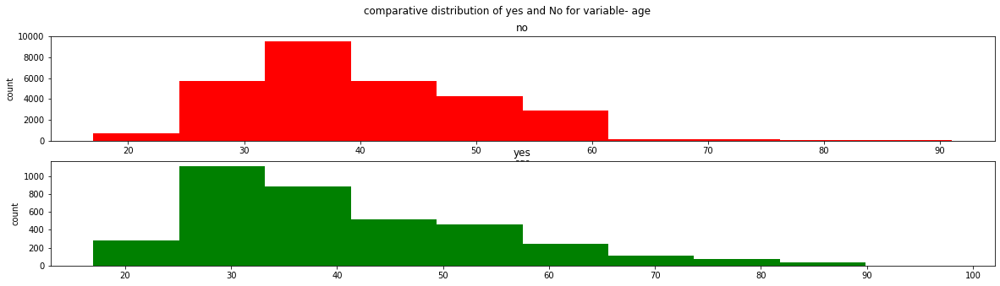

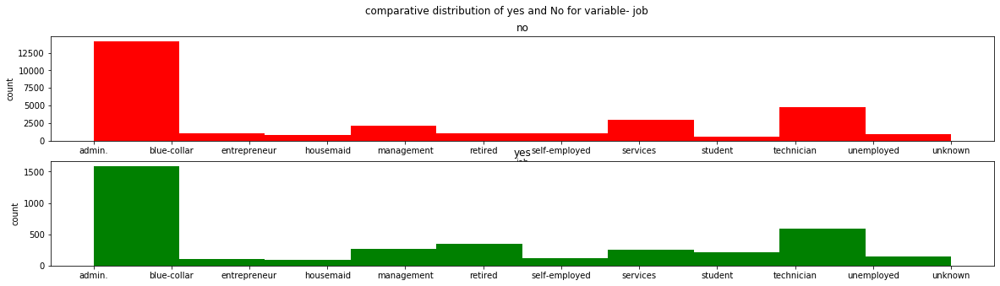

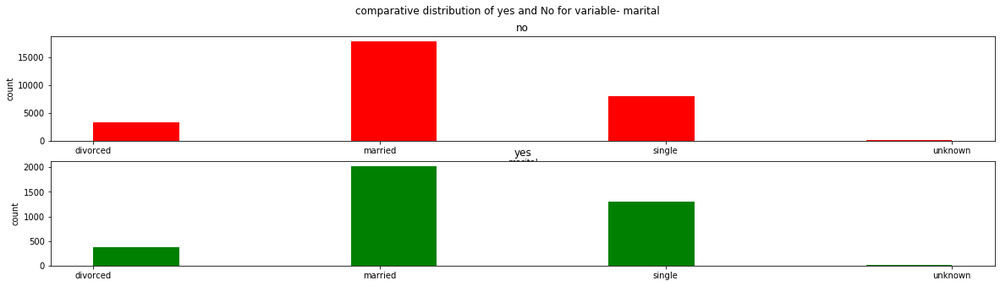

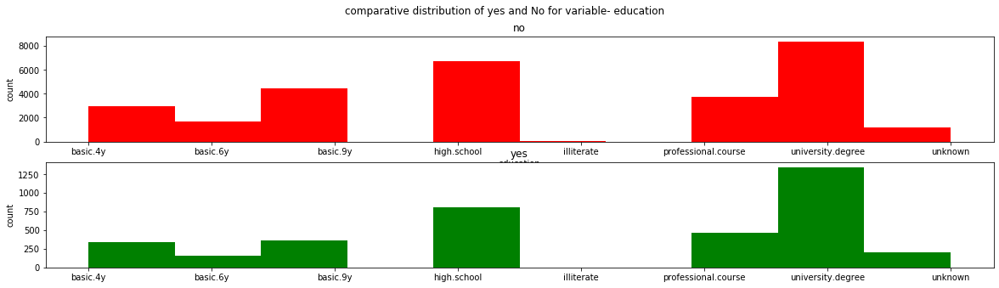

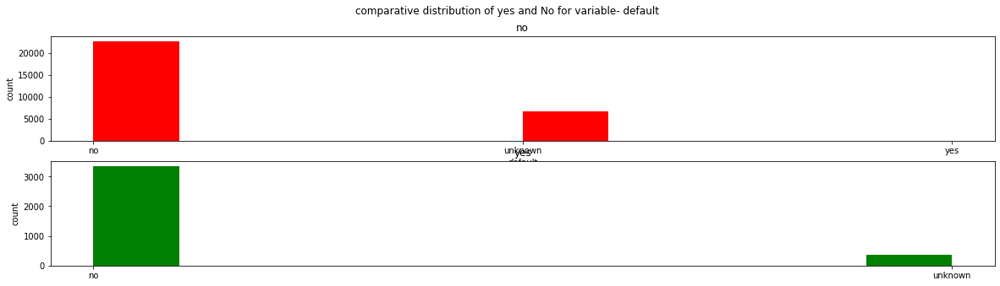

...

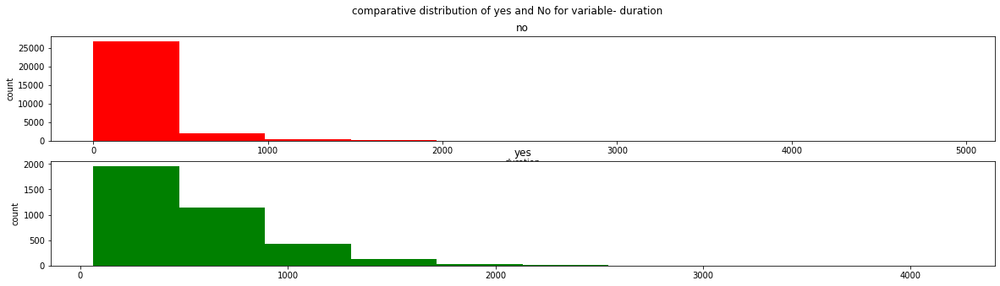

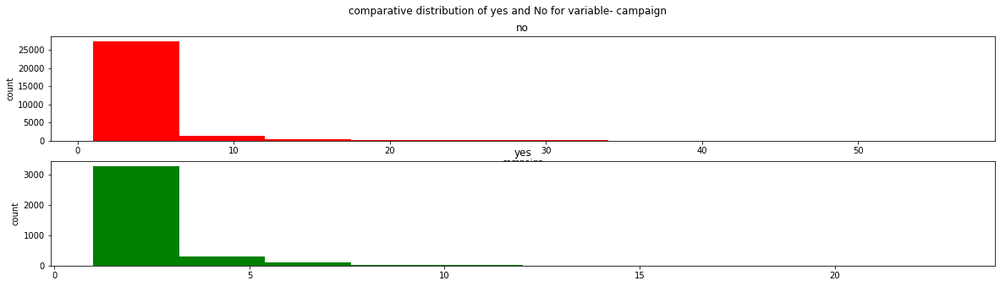

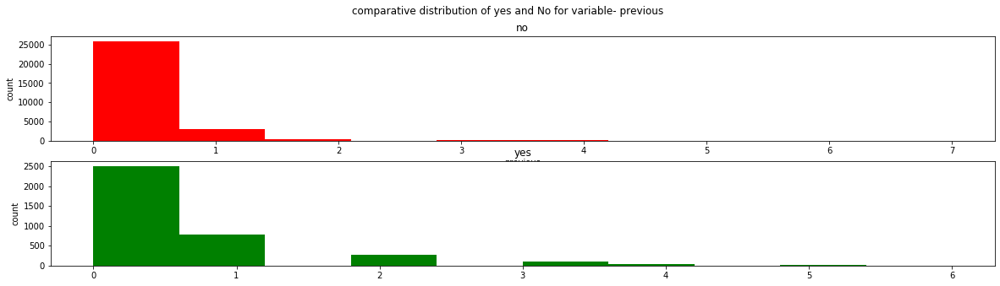

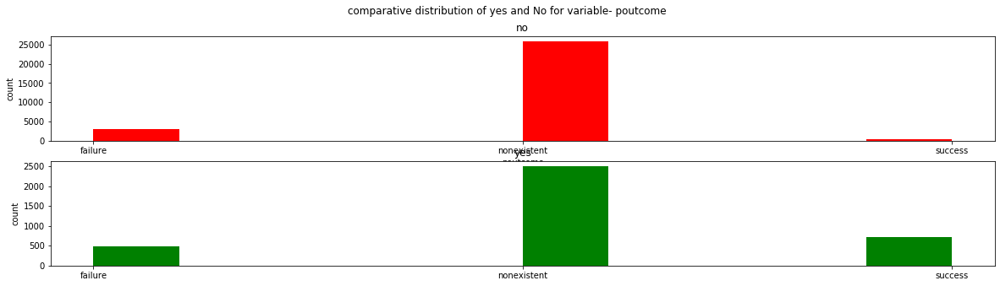

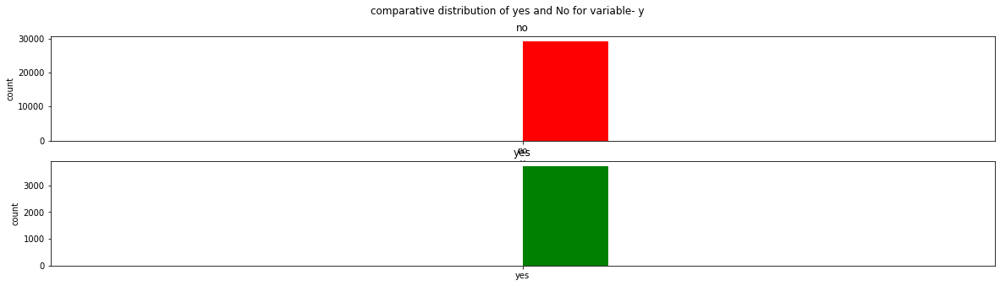

In [36]:
for c in train.columns:
    
    plt.figure(figsize=(20,5))
    plt.suptitle('comparative distribution of yes and No for variable- '+ c)
    plt.subplot(2, 1, 1)
    plt.title('no')
    plt.xlabel(c)
    plt.ylabel('count')
    train_no.sort_values(by=[c], inplace=True)
    train_yes.sort_values(by=[c], inplace=True)
    plt.hist(train_no[c], color='red')
    plt.subplot(2, 1, 2)
    plt.title('yes')
    plt.ylabel('count')
    plt.hist(train_yes[c], color='green')

### observation 3-  Age and duration has less unique values, can be binned for experiment

In [38]:
import h2o

## building a standard model h2o

In [71]:
from sklearn.model_selection import train_test_split
X_train, X_test= train_test_split(train, test_size=0.33)

In [40]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: java version "16.0.2" 2021-07-20; Java(TM) SE Runtime Environment (build 16.0.2+7-67); Java HotSpot(TM) 64-Bit Server VM (build 16.0.2+7-67, mixed mode, sharing)
  Starting server from /opt/anaconda3/lib/python3.7/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /var/folders/k4/clpf25mj199cvc7r2s8grfj80000gn/T/tmpvi7mez1e
  JVM stdout: /var/folders/k4/clpf25mj199cvc7r2s8grfj80000gn/T/tmpvi7mez1e/h2o_apple_started_from_python.out
  JVM stderr: /var/folders/k4/clpf25mj199cvc7r2s8grfj80000gn/T/tmpvi7mez1e/h2o_apple_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.34.0.3
H2O_cluster_version_age:,3 months and 3 days
H2O_cluster_name:,H2O_from_python_apple_ad4xao
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,4 Gb
H2O_cluster_total_cores:,16
H2O_cluster_allowed_cores:,16
H2O_cluster_status:,"locked, healthy"


In [72]:
train_df = h2o.H2OFrame(X_train)


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [73]:
train_df.describe()

Rows:22049
Cols:15




,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,previous,poutcome,y
type,int,enum,enum,enum,enum,enum,enum,enum,enum,enum,int,int,int,enum,enum
mins,17.0,,,,,,,,,,0.0,1.0,0.0,,
mean,40.03510363281767,,,,,,,,,,257.4836500521562,2.558347317338666,0.1786475577123675,,
maxs,91.0,,,,,,,,,,4918.0,43.0,7.0,,
sigma,10.464417276048321,,,,,,,,,,257.01219951256667,2.7605121861285706,0.5054720195461277,,
zeros,0,,,,,,,,,,2,0,18959,,
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,43.0,blue-collar,married,basic.9y,no,yes,no,telephone,may,wed,141.0,2.0,0.0,nonexistent,no
1,51.0,blue-collar,married,unknown,unknown,no,no,telephone,may,mon,243.0,1.0,0.0,nonexistent,no
2,24.0,student,single,university.degree,no,no,no,cellular,jun,mon,223.0,1.0,0.0,nonexistent,no


In [74]:
# creating columns for h2o auto ml
x = train_df.columns
y = 'y'
# remove label classvariable from feature variable
x.remove(y)


In [75]:
from h2o.automl import H2OAutoML
aml = H2OAutoML(max_runtime_secs = 600,
                # exclude_algos =['DeepLearning'],
                seed = 1,
                # stopping_metric ='logloss',
                # sort_metric ='logloss',
                balance_classes = True)

In [76]:
# train model and record time % time
aml.train(x = x, y = y, training_frame = train_df)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OStackedEnsembleEstimator :  Stacked Ensemble
Model Key:  StackedEnsemble_AllModels_3_AutoML_2_20220110_143434

No model summary for this model

ModelMetricsBinomialGLM: stackedensemble
** Reported on train data. **

MSE: 0.041714122896438964
RMSE: 0.20424035569994234
LogLoss: 0.14026402390345494
Null degrees of freedom: 10014
Residual degrees of freedom: 9991
Null deviance: 7128.499473454892
Residual deviance: 2809.488398786202
AIC: 2857.488398786202
AUC: 0.97468676498752
AUCPR: 0.8533931060046307
Gini: 0.9493735299750401

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4171899816693232: 


,,no,yes,Error,Rate
0,no,8589.0,279.0,0.0315,(279.0/8868.0)
1,yes,266.0,881.0,0.2319,(266.0/1147.0)
2,Total,8855.0,1160.0,0.0544,(545.0/10015.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.417190,0.763762,162.0
1,max f2,0.202755,0.823493,243.0
2,max f0point5,0.566599,0.804310,108.0
3,max accuracy,0.465359,0.946480,146.0
4,max precision,0.936858,1.000000,0.0
5,max recall,0.021211,1.000000,355.0
6,max specificity,0.936858,1.000000,0.0
7,max absolute_mcc,0.417190,0.733027,162.0
8,max min_per_class_accuracy,0.228467,0.913171,232.0
9,max mean_per_class_accuracy,0.198515,0.919828,245.0



Gains/Lift Table: Avg response rate: 11.45 %, avg score: 11.60 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010085,0.836666,8.731473,8.731473,1.000000,0.873721,1.000000,0.873721,0.088056,0.088056,773.147341,773.147341,0.088056
1,2,0.020070,0.764600,8.382214,8.557713,0.960000,0.802534,0.980100,0.838305,0.083697,0.171752,738.221447,755.771274,0.171301
2,3,0.030055,0.715271,8.556844,8.557424,0.980000,0.738412,0.980066,0.805118,0.085440,0.257193,755.684394,755.742411,0.256516
3,4,0.040040,0.678419,8.207585,8.470182,0.940000,0.695554,0.970075,0.777795,0.081953,0.339146,720.758500,747.018243,0.337792
4,5,0.050025,0.643309,7.683697,8.313199,0.880000,0.661075,0.952096,0.754498,0.076722,0.415867,668.369660,731.319923,0.413161
5,6,0.100050,0.471025,5.716414,7.014806,0.654691,0.553527,0.803393,0.654012,0.285963,0.701831,471.641373,601.480648,0.679616
6,7,0.150075,0.310526,3.171912,5.733842,0.363273,0.387699,0.656687,0.565241,0.158675,0.860506,217.191250,473.384182,0.802319
7,8,0.200000,0.184656,1.641517,4.712293,0.188000,0.245051,0.539690,0.485314,0.081953,0.942459,64.151700,371.229294,0.838489
8,9,0.300050,0.065951,0.453130,3.292100,0.051896,0.113481,0.377038,0.361328,0.045336,0.987794,-54.686964,229.209962,0.776698
9,10,0.400000,0.025503,0.113396,2.497820,0.012987,0.041294,0.286071,0.281360,0.011334,0.999128,-88.660424,149.782040,0.676620




ModelMetricsBinomialGLM: stackedensemble
** Reported on cross-validation data. **

MSE: 0.06119356108404956
RMSE: 0.24737332330720213
LogLoss: 0.19619892710258013
Null degrees of freedom: 22048
Residual degrees of freedom: 22026
Null deviance: 15553.291967985886
Residual deviance: 8651.980287369579
AIC: 8697.980287369579
AUC: 0.9313015248390473
AUCPR: 0.6140957537014874
Gini: 0.8626030496780945

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.29326312175465025: 


,,no,yes,Error,Rate
0,no,17991.0,1567.0,0.0801,(1567.0/19558.0)
1,yes,669.0,1822.0,0.2686,(669.0/2491.0)
2,Total,18660.0,3389.0,0.1014,(2236.0/22049.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.293263,0.619728,213.0
1,max f2,0.157727,0.723317,271.0
2,max f0point5,0.463638,0.607417,146.0
3,max accuracy,0.500359,0.911787,133.0
4,max precision,0.952265,1.000000,0.0
5,max recall,0.000746,1.000000,398.0
6,max specificity,0.952265,1.000000,0.0
7,max absolute_mcc,0.258577,0.573766,228.0
8,max min_per_class_accuracy,0.147380,0.859955,276.0
9,max mean_per_class_accuracy,0.098539,0.863072,302.0



Gains/Lift Table: Avg response rate: 11.30 %, avg score: 11.29 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010023,0.808682,7.249390,7.249390,0.819005,0.852412,0.819005,0.852412,0.072662,0.072662,624.939011,624.939011,0.070616
1,2,0.020001,0.729587,6.236260,6.743974,0.704545,0.765992,0.761905,0.809300,0.062224,0.134886,523.625963,574.397354,0.129517
2,3,0.030024,0.685448,6.087886,6.524947,0.687783,0.707034,0.737160,0.775160,0.061020,0.195905,508.788562,552.494721,0.187009
3,4,0.040002,0.647427,5.592517,6.292368,0.631818,0.665641,0.710884,0.747842,0.055801,0.251706,459.251670,529.236817,0.238668
4,5,0.050025,0.611196,5.286848,6.090899,0.597285,0.628599,0.688123,0.723950,0.052991,0.304697,428.684804,509.089950,0.287108
5,6,0.100005,0.454054,4.851438,5.471450,0.548094,0.529896,0.618141,0.626967,0.242473,0.547170,385.143832,447.144996,0.504118
6,7,0.150029,0.303871,3.450707,4.797665,0.389846,0.377814,0.542019,0.543891,0.172621,0.719791,245.070722,379.766543,0.642329
7,8,0.200009,0.183812,2.224915,4.154769,0.251361,0.238625,0.469388,0.467609,0.111200,0.830992,122.491459,315.476941,0.711347
8,9,0.300014,0.067619,1.023639,3.111059,0.115646,0.114461,0.351474,0.349893,0.102369,0.933360,2.363884,211.105922,0.714013
9,10,0.400018,0.027256,0.401427,2.433651,0.045351,0.043870,0.274943,0.273387,0.040145,0.973505,-59.857300,143.365117,0.646528


In [77]:
# View the H2O aml leaderboard
lb = aml.leaderboard
# Print all rows instead of 10 rows
lb.head(rows = lb.nrows)

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse
StackedEnsemble_AllModels_3_AutoML_2_20220110_143434,0.931302,0.196199,0.614096,0.174344,0.247373,0.0611936
StackedEnsemble_AllModels_4_AutoML_2_20220110_143434,0.931239,0.196274,0.613194,0.159494,0.247416,0.0612145
StackedEnsemble_AllModels_2_AutoML_2_20220110_143434,0.931162,0.196214,0.612836,0.175882,0.247194,0.0611048
StackedEnsemble_BestOfFamily_3_AutoML_2_20220110_143434,0.930825,0.196582,0.612347,0.169461,0.247609,0.06131
StackedEnsemble_BestOfFamily_4_AutoML_2_20220110_143434,0.930406,0.196868,0.614245,0.178393,0.247674,0.0613424
StackedEnsemble_AllModels_1_AutoML_2_20220110_143434,0.929623,0.198038,0.608969,0.181462,0.248029,0.0615183
StackedEnsemble_BestOfFamily_1_AutoML_2_20220110_143434,0.929358,0.199711,0.601662,0.180809,0.249313,0.0621569
GBM_grid_1_AutoML_2_20220110_143434_model_6,0.929319,0.200572,0.61059,0.178069,0.250043,0.0625215
GBM_grid_1_AutoML_2_20220110_143434_model_9,0.929301,0.201289,0.606179,0.169759,0.25086,0.0629308
GBM_grid_1_AutoML_2_20220110_143434_model_2,0.92913,0.199622,0.605719,0.173626,0.2495,0.0622501


In [78]:
# Get the top model of leaderboard
se = aml.leader
 
# Get the metalearner model of top model
metalearner = h2o.get_model(se.metalearner()['name'])
 
# list baselearner models :
metalearner.varimp()

/opt/anaconda3/lib/python3.7/site-packages/h2o/estimators/stackedensemble.py:929: H2ODeprecationWarning: The usage of stacked_ensemble.metalearner()['name'] will be deprecated. Metalearner now returns the metalearner object. If you need to get the 'name' please use stacked_ensemble.metalearner().model_id
  H2ODeprecationWarning


[('DeepLearning_1_AutoML_2_20220110_143434',
  0.5293430685997009,
  1.0,
  0.19823279061779936),
 ('GBM_grid_1_AutoML_2_20220110_143434_model_2',
  0.3082195818424225,
  0.5822680981877632,
  0.11542462999147908),
 ('GBM_5_AutoML_2_20220110_143434',
  0.2985777258872986,
  0.5640533400713869,
  0.1118138676596416),
 ('DeepLearning_grid_1_AutoML_2_20220110_143434_model_2',
  0.2589722275733948,
  0.48923324576340943,
  0.09698207157068431),
 ('GBM_1_AutoML_2_20220110_143434',
  0.20339879393577576,
  0.3842475815803866,
  0.07617047038482055),
 ('GBM_grid_1_AutoML_2_20220110_143434_model_17',
  0.15718825161457062,
  0.2969496739239242,
  0.058865162534985055),
 ('GBM_grid_1_AutoML_2_20220110_143434_model_4',
  0.15222658216953278,
  0.28757641537127476,
  0.0570070753349112),
 ('DRF_1_AutoML_2_20220110_143434',
  0.12417598813772202,
  0.2345850838591526,
  0.0465024558107103),
 ('GBM_2_AutoML_2_20220110_143434',
  0.10819391906261444,
  0.20439281343349883,
  0.0405173577891457),
 ('

In [79]:
model = h2o.get_model('DeepLearning_1_AutoML_2_20220110_143434')

test_df=h2o.H2OFrame(X_test)
pred=model.predict(test_df)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
deeplearning prediction progress: |██████████████████████████████████████████████| (done) 100%


### checking model performance

In [94]:
from sklearn.metrics import classification_report
y_true=test_df['y'].as_data_frame()
type(y_true)
y_true['y']

0         no
1         no
2         no
3         no
4         no
        ... 
10856     no
10857    yes
10858    yes
10859     no
10860     no
Name: y, Length: 10861, dtype: object

In [100]:
y_true_class=[0 if x =='no' else 1 for x in y_true['y']]
pred_class=[0 if x =='no' else 1 for x in pred.as_data_frame()['predict']]

In [101]:
print(classification_report(y_true_class,pred_class))

              precision    recall  f1-score   support

           0       0.98      0.81      0.89      9645
           1       0.37      0.89      0.52      1216

    accuracy                           0.81     10861
   macro avg       0.67      0.85      0.70     10861
weighted avg       0.91      0.81      0.84     10861



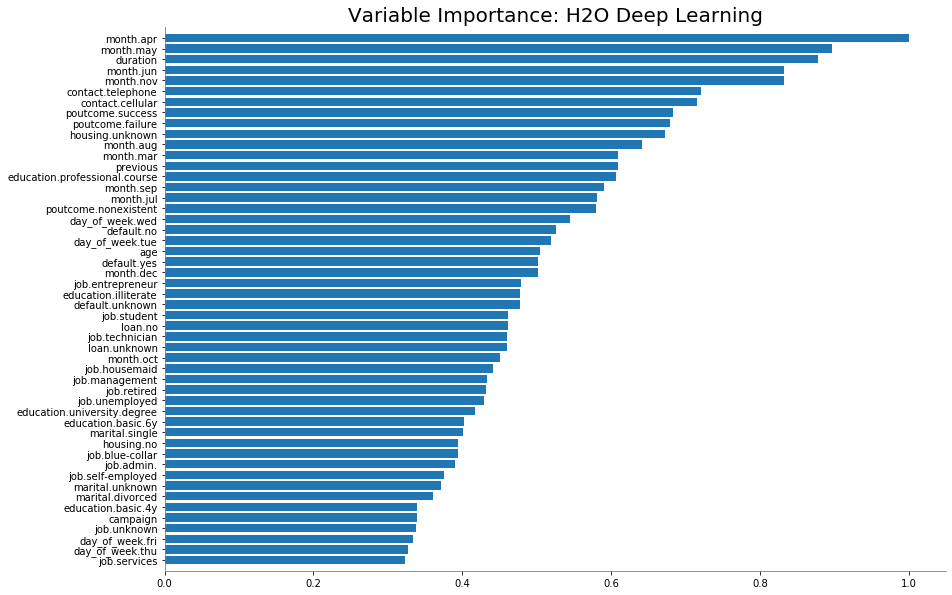

In [104]:
model.varimp_plot(num_of_features=50)

In [195]:
# Convert target variable into numeric to see corelation analysis
data=train
data.y = data.y.map({'no':0, 'yes':1}).astype('uint8')
# Build correlation matrix
corr = data.corr()
corr.style.background_gradient(cmap='PuBu')

,age,duration,campaign,previous,y
age,1.000000,-0.001741,0.003406,0.020794,0.028860
duration,-0.001741,1.000000,-0.075651,0.022585,0.400887
campaign,0.003406,-0.075651,1.000000,-0.078974,-0.065425
previous,0.020794,0.022585,-0.078974,1.000000,0.229876
y,0.028860,0.400887,-0.065425,0.229876,1.000000


Text(0.5, 1.0, 'duration density plot')

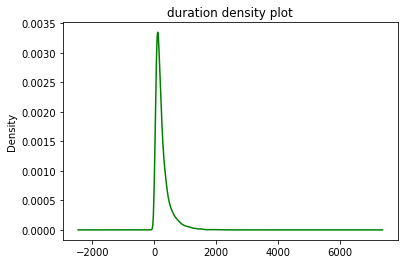

In [107]:
train.duration.plot.density(color='green')
plt.title('duration density plot')

Text(0.5, 1.0, 'age density plot')

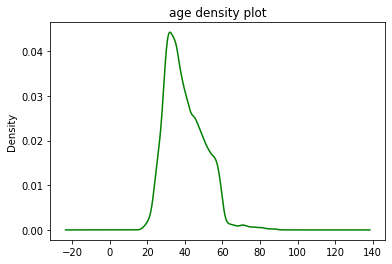

In [108]:
train.age.plot.density(color='green')
plt.title('age density plot')

In [110]:
print(min(train.age), min(train.duration))

17 0


## Running Catboost Model

In [116]:
X_train
X_test
from catboost import CatBoostClassifier
X_train.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'previous',
       'poutcome', 'y'],
      dtype='object')

In [132]:
cat_cols=[1,2,3,4,5,6,7,8,9,13]
cat_train_labels=X_train.y
cat_X_train=X_train.iloc[:,0:-1]

In [127]:
cat_model = CatBoostClassifier(iterations=1000,
                           learning_rate=.001,
                           depth=8)
# Fit model
cat_model.fit(cat_X_train, cat_train_labels, cat_cols, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6917259	total: 32.3ms	remaining: 32.2s
1:	learn: 0.6905230	total: 58.1ms	remaining: 29s
2:	learn: 0.6892441	total: 86.4ms	remaining: 28.7s
3:	learn: 0.6878894	total: 116ms	remaining: 28.8s
4:	learn: 0.6867933	total: 129ms	remaining: 25.8s
5:	learn: 0.6855012	total: 159ms	remaining: 26.3s
6:	learn: 0.6843998	total: 179ms	remaining: 25.4s
7:	learn: 0.6831905	total: 197ms	remaining: 24.5s
8:	learn: 0.6819732	total: 224ms	remaining: 24.7s
9:	learn: 0.6807064	total: 246ms	remaining: 24.3s
10:	learn: 0.6792810	total: 278ms	remaining: 25s
11:	learn: 0.6779125	total: 300ms	remaining: 24.7s
12:	learn: 0.6766718	total: 320ms	remaining: 24.3s
13:	learn: 0.6754058	total: 341ms	remaining: 24s
14:	learn: 0.6741573	total: 359ms	remaining: 23.5s
15:	learn: 0.6728741	total: 371ms	remaining: 22.8s
16:	learn: 0.6716105	total: 390ms	remaining: 22.6s
17:	learn: 0.6704611	total: 403ms	remaining: 22s
18:	learn: 0.6691380	total: 421ms	remaining: 21.7s
19:	learn: 0.6678324	total: 440ms	remaining: 2

170:	learn: 0.5231929	total: 2.97s	remaining: 14.4s
171:	learn: 0.5225065	total: 2.99s	remaining: 14.4s
172:	learn: 0.5215238	total: 3.01s	remaining: 14.4s
173:	learn: 0.5206891	total: 3.03s	remaining: 14.4s
174:	learn: 0.5199553	total: 3.04s	remaining: 14.3s
175:	learn: 0.5191674	total: 3.06s	remaining: 14.3s
176:	learn: 0.5184517	total: 3.08s	remaining: 14.3s
177:	learn: 0.5176938	total: 3.09s	remaining: 14.3s
178:	learn: 0.5168902	total: 3.1s	remaining: 14.2s
179:	learn: 0.5162456	total: 3.12s	remaining: 14.2s
180:	learn: 0.5153398	total: 3.14s	remaining: 14.2s
181:	learn: 0.5146927	total: 3.15s	remaining: 14.2s
182:	learn: 0.5139155	total: 3.17s	remaining: 14.2s
183:	learn: 0.5132490	total: 3.18s	remaining: 14.1s
184:	learn: 0.5124483	total: 3.2s	remaining: 14.1s
185:	learn: 0.5117743	total: 3.21s	remaining: 14s
186:	learn: 0.5109643	total: 3.22s	remaining: 14s
187:	learn: 0.5102498	total: 3.24s	remaining: 14s
188:	learn: 0.5096672	total: 3.25s	remaining: 13.9s
189:	learn: 0.509017

338:	learn: 0.4207448	total: 5.68s	remaining: 11.1s
339:	learn: 0.4202514	total: 5.7s	remaining: 11.1s
340:	learn: 0.4197402	total: 5.72s	remaining: 11.1s
341:	learn: 0.4193136	total: 5.73s	remaining: 11s
342:	learn: 0.4189494	total: 5.74s	remaining: 11s
343:	learn: 0.4185610	total: 5.75s	remaining: 11s
344:	learn: 0.4181718	total: 5.76s	remaining: 10.9s
345:	learn: 0.4177110	total: 5.77s	remaining: 10.9s
346:	learn: 0.4172165	total: 5.79s	remaining: 10.9s
347:	learn: 0.4168061	total: 5.8s	remaining: 10.9s
348:	learn: 0.4162948	total: 5.82s	remaining: 10.8s
349:	learn: 0.4158345	total: 5.83s	remaining: 10.8s
350:	learn: 0.4153492	total: 5.84s	remaining: 10.8s
351:	learn: 0.4149601	total: 5.86s	remaining: 10.8s
352:	learn: 0.4145155	total: 5.87s	remaining: 10.8s
353:	learn: 0.4141403	total: 5.88s	remaining: 10.7s
354:	learn: 0.4137284	total: 5.89s	remaining: 10.7s
355:	learn: 0.4132652	total: 5.9s	remaining: 10.7s
356:	learn: 0.4126925	total: 5.92s	remaining: 10.7s
357:	learn: 0.4122784

503:	learn: 0.3505196	total: 8.86s	remaining: 8.72s
504:	learn: 0.3501191	total: 8.9s	remaining: 8.72s
505:	learn: 0.3498295	total: 8.92s	remaining: 8.71s
506:	learn: 0.3494294	total: 8.97s	remaining: 8.73s
507:	learn: 0.3490254	total: 9.01s	remaining: 8.72s
508:	learn: 0.3486097	total: 9.04s	remaining: 8.72s
509:	learn: 0.3482873	total: 9.07s	remaining: 8.71s
510:	learn: 0.3479154	total: 9.1s	remaining: 8.71s
511:	learn: 0.3475779	total: 9.13s	remaining: 8.7s
512:	learn: 0.3473150	total: 9.16s	remaining: 8.69s
513:	learn: 0.3470100	total: 9.18s	remaining: 8.68s
514:	learn: 0.3466206	total: 9.2s	remaining: 8.67s
515:	learn: 0.3464231	total: 9.22s	remaining: 8.65s
516:	learn: 0.3460918	total: 9.24s	remaining: 8.63s
517:	learn: 0.3458332	total: 9.28s	remaining: 8.63s
518:	learn: 0.3454333	total: 9.31s	remaining: 8.63s
519:	learn: 0.3451355	total: 9.33s	remaining: 8.61s
520:	learn: 0.3446916	total: 9.36s	remaining: 8.61s
521:	learn: 0.3444405	total: 9.39s	remaining: 8.6s
522:	learn: 0.344

669:	learn: 0.3025331	total: 14.4s	remaining: 7.09s
670:	learn: 0.3023938	total: 14.4s	remaining: 7.07s
671:	learn: 0.3021683	total: 14.4s	remaining: 7.05s
672:	learn: 0.3019412	total: 14.5s	remaining: 7.04s
673:	learn: 0.3016841	total: 14.5s	remaining: 7.03s
674:	learn: 0.3014151	total: 14.6s	remaining: 7.02s
675:	learn: 0.3012511	total: 14.6s	remaining: 7s
676:	learn: 0.3010796	total: 14.6s	remaining: 6.98s
677:	learn: 0.3008243	total: 14.7s	remaining: 6.97s
678:	learn: 0.3005919	total: 14.7s	remaining: 6.95s
679:	learn: 0.3003746	total: 14.7s	remaining: 6.94s
680:	learn: 0.3001636	total: 14.8s	remaining: 6.93s
681:	learn: 0.2999281	total: 14.8s	remaining: 6.92s
682:	learn: 0.2996533	total: 14.9s	remaining: 6.9s
683:	learn: 0.2994405	total: 14.9s	remaining: 6.89s
684:	learn: 0.2992144	total: 14.9s	remaining: 6.87s
685:	learn: 0.2990830	total: 15s	remaining: 6.85s
686:	learn: 0.2988496	total: 15s	remaining: 6.83s
687:	learn: 0.2986381	total: 15s	remaining: 6.82s
688:	learn: 0.2983986	

832:	learn: 0.2726070	total: 18.4s	remaining: 3.69s
833:	learn: 0.2724469	total: 18.4s	remaining: 3.67s
834:	learn: 0.2723241	total: 18.4s	remaining: 3.65s
835:	learn: 0.2722389	total: 18.5s	remaining: 3.62s
836:	learn: 0.2720918	total: 18.5s	remaining: 3.6s
837:	learn: 0.2719650	total: 18.5s	remaining: 3.58s
838:	learn: 0.2717955	total: 18.5s	remaining: 3.56s
839:	learn: 0.2716534	total: 18.6s	remaining: 3.53s
840:	learn: 0.2714675	total: 18.6s	remaining: 3.51s
841:	learn: 0.2713260	total: 18.6s	remaining: 3.49s
842:	learn: 0.2711994	total: 18.6s	remaining: 3.47s
843:	learn: 0.2710528	total: 18.6s	remaining: 3.44s
844:	learn: 0.2709044	total: 18.7s	remaining: 3.42s
845:	learn: 0.2707530	total: 18.7s	remaining: 3.4s
846:	learn: 0.2706078	total: 18.7s	remaining: 3.38s
847:	learn: 0.2705469	total: 18.7s	remaining: 3.35s
848:	learn: 0.2704676	total: 18.7s	remaining: 3.33s
849:	learn: 0.2703408	total: 18.7s	remaining: 3.31s
850:	learn: 0.2702049	total: 18.8s	remaining: 3.28s
851:	learn: 0.

992:	learn: 0.2534256	total: 25.8s	remaining: 182ms
993:	learn: 0.2533175	total: 25.8s	remaining: 156ms
994:	learn: 0.2532264	total: 25.8s	remaining: 130ms
995:	learn: 0.2531245	total: 25.9s	remaining: 104ms
996:	learn: 0.2530145	total: 25.9s	remaining: 78ms
997:	learn: 0.2529133	total: 26s	remaining: 52ms
998:	learn: 0.2527899	total: 26s	remaining: 26ms
999:	learn: 0.2526711	total: 26s	remaining: 0us


In [130]:
cat_test_labels=X_test.y
cat_X_test=X_test.iloc[:,0:-1]
cat_preds_class = cat_model.predict(cat_X_test)
print(classification_report(cat_test_labels,cat_preds_class))

              precision    recall  f1-score   support

          no       0.92      0.98      0.95      9645
         yes       0.68      0.32      0.44      1216

    accuracy                           0.91     10861
   macro avg       0.80      0.65      0.69     10861
weighted avg       0.89      0.91      0.89     10861



## regularization check

In [133]:
cat_preds_class_train=cat_model.predict(cat_X_train)
print(classification_report(cat_train_labels,cat_preds_class_train))

              precision    recall  f1-score   support

          no       0.92      0.98      0.95     19558
         yes       0.69      0.32      0.44      2491

    accuracy                           0.91     22049
   macro avg       0.81      0.65      0.69     22049
weighted avg       0.89      0.91      0.89     22049



## grid search catboost

In [142]:
grid = {'max_depth': [8,10,14],'n_estimators':[2000, 1500],'l2_leaf_reg':[5,15,30,100], 'border_count':[10,20,50,254]}

In [143]:
cbc = CatBoostClassifier(cat_features=cat_cols)
#Instantiate GridSearchCV
gscv = cbc.grid_search (grid,cat_X_train, cat_train_labels, cv = 3,train_size=0.8,
            verbose=True,
            plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 0.2074889718
bestIteration = 596

0:	loss: 0.2074890	best: 0.2074890 (0)	total: 45.4s	remaining: 1h 11m 48s

bestTest = 0.2068699063
bestIteration = 1285

1:	loss: 0.2068699	best: 0.2068699 (1)	total: 1m 31s	remaining: 1h 11m 19s

bestTest = 0.207392315
bestIteration = 1884

2:	loss: 0.2073923	best: 0.2068699 (1)	total: 2m 24s	remaining: 1h 14m 34s

bestTest = 0.2084238413
bestIteration = 1997

3:	loss: 0.2084238	best: 0.2068699 (1)	total: 3m 17s	remaining: 1h 15m 34s

bestTest = 0.2074889718
bestIteration = 596

4:	loss: 0.2074890	best: 0.2068699 (1)	total: 4m 1s	remaining: 1h 13m 8s

bestTest = 0.2068699063
bestIteration = 1285

5:	loss: 0.2068699	best: 0.2068699 (1)	total: 5m	remaining: 1h 15m 2s

bestTest = 0.207630076
bestIteration = 1499

6:	loss: 0.2076301	best: 0.2068699 (1)	total: 5m 41s	remaining: 1h 12m 19s

bestTest = 0.2098276393
bestIteration = 1499

7:	loss: 0.2098276	best: 0.2068699 (1)	total: 6m 21s	remaining: 1h 9m 53s

bestTest = 0.2085054952
bestIteratio


bestTest = 0.2013576652
bestIteration = 570

61:	loss: 0.2013577	best: 0.1996187 (48)	total: 4h 58m 28s	remaining: 3h 7m 55s

bestTest = 0.2007659258
bestIteration = 513

62:	loss: 0.2007659	best: 0.1996187 (48)	total: 4h 59m 35s	remaining: 2h 59m 45s

bestTest = 0.2012753362
bestIteration = 1494

63:	loss: 0.2012753	best: 0.1996187 (48)	total: 5h 43s	remaining: 2h 51m 50s

bestTest = 0.2040955454
bestIteration = 276

64:	loss: 0.2040955	best: 0.1996187 (48)	total: 5h 36m 7s	remaining: 3h 2m 48s

bestTest = 0.2032496764
bestIteration = 555


Iteration with suspicious time -9.23e+03 sec ignored in overall statistics.
65:	loss: 0.2032497	best: 0.1996187 (48)	total: 5h 36m 7s	remaining: 3h 2m 48s

bestTest = 0.2035560105
bestIteration = 703

66:	loss: 0.2035560	best: 0.1996187 (48)	total: 5h 55m 23s	remaining: 2h 57m 41s

bestTest = 0.2024295656
bestIteration = 1607

67:	loss: 0.2024296	best: 0.1996187 (48)	total: 6h 23m 37s	remaining: 3h 2m 3s

bestTest = 0.2040955454
bestIteration = 27

In [154]:
best_cbc = CatBoostClassifier(cat_features=cat_cols,border_count=50, depth=8, l2_leaf_reg=5, iterations=2000)

In [157]:
best_cbc.fit(cat_X_train, cat_train_labels,cat_cols, plot =True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6544363	total: 39.3ms	remaining: 1m 18s
1:	learn: 0.6162919	total: 74.4ms	remaining: 1m 14s
2:	learn: 0.5872671	total: 94.9ms	remaining: 1m 3s
3:	learn: 0.5584650	total: 127ms	remaining: 1m 3s
4:	learn: 0.5292523	total: 162ms	remaining: 1m 4s
5:	learn: 0.5028299	total: 194ms	remaining: 1m 4s
6:	learn: 0.4834471	total: 225ms	remaining: 1m 4s
7:	learn: 0.4600629	total: 264ms	remaining: 1m 5s
8:	learn: 0.4412248	total: 296ms	remaining: 1m 5s
9:	learn: 0.4267581	total: 317ms	remaining: 1m 3s
10:	learn: 0.4135157	total: 332ms	remaining: 1m
11:	learn: 0.3948354	total: 366ms	remaining: 1m
12:	learn: 0.3843057	total: 383ms	remaining: 58.6s
13:	learn: 0.3742359	total: 400ms	remaining: 56.7s
14:	learn: 0.3596253	total: 424ms	remaining: 56.1s
15:	learn: 0.3470303	total: 450ms	remaining: 55.8s
16:	learn: 0.3385739	total: 463ms	remaining: 54s
17:	learn: 0.3276760	total: 491ms	remaining: 54s
18:	learn: 0.3186333	total: 512ms	remaining: 53.3s
19:	learn: 0.3106741	total: 528ms	remaining: 5

167:	learn: 0.1862428	total: 3.87s	remaining: 42.3s
168:	learn: 0.1862359	total: 3.89s	remaining: 42.2s
169:	learn: 0.1862355	total: 3.9s	remaining: 42s
170:	learn: 0.1861619	total: 3.92s	remaining: 42s
171:	learn: 0.1860970	total: 3.94s	remaining: 41.9s
172:	learn: 0.1859838	total: 3.96s	remaining: 41.9s
173:	learn: 0.1858400	total: 3.99s	remaining: 41.9s
174:	learn: 0.1858330	total: 4s	remaining: 41.8s
175:	learn: 0.1858270	total: 4.01s	remaining: 41.6s
176:	learn: 0.1858263	total: 4.02s	remaining: 41.4s
177:	learn: 0.1858139	total: 4.04s	remaining: 41.4s
178:	learn: 0.1857879	total: 4.06s	remaining: 41.3s
179:	learn: 0.1856705	total: 4.09s	remaining: 41.4s
180:	learn: 0.1855685	total: 4.12s	remaining: 41.4s
181:	learn: 0.1855673	total: 4.12s	remaining: 41.2s
182:	learn: 0.1855076	total: 4.14s	remaining: 41.1s
183:	learn: 0.1854730	total: 4.16s	remaining: 41.1s
184:	learn: 0.1854648	total: 4.17s	remaining: 41s
185:	learn: 0.1853572	total: 4.19s	remaining: 40.9s
186:	learn: 0.1852572	

333:	learn: 0.1756146	total: 7.24s	remaining: 36.1s
334:	learn: 0.1756146	total: 7.25s	remaining: 36s
335:	learn: 0.1755635	total: 7.27s	remaining: 36s
336:	learn: 0.1753814	total: 7.29s	remaining: 36s
337:	learn: 0.1753636	total: 7.31s	remaining: 35.9s
338:	learn: 0.1753549	total: 7.33s	remaining: 35.9s
339:	learn: 0.1753549	total: 7.33s	remaining: 35.8s
340:	learn: 0.1753020	total: 7.36s	remaining: 35.8s
341:	learn: 0.1753019	total: 7.37s	remaining: 35.7s
342:	learn: 0.1752637	total: 7.43s	remaining: 35.9s
343:	learn: 0.1751888	total: 7.47s	remaining: 36s
344:	learn: 0.1750957	total: 7.49s	remaining: 35.9s
345:	learn: 0.1750355	total: 7.51s	remaining: 35.9s
346:	learn: 0.1748858	total: 7.53s	remaining: 35.9s
347:	learn: 0.1748856	total: 7.54s	remaining: 35.8s
348:	learn: 0.1748815	total: 7.56s	remaining: 35.8s
349:	learn: 0.1748811	total: 7.57s	remaining: 35.7s
350:	learn: 0.1748365	total: 7.59s	remaining: 35.7s
351:	learn: 0.1747641	total: 7.61s	remaining: 35.6s
352:	learn: 0.174752

500:	learn: 0.1689177	total: 10.9s	remaining: 32.6s
501:	learn: 0.1689138	total: 10.9s	remaining: 32.5s
502:	learn: 0.1689092	total: 10.9s	remaining: 32.5s
503:	learn: 0.1688328	total: 11s	remaining: 32.6s
504:	learn: 0.1688026	total: 11s	remaining: 32.6s
505:	learn: 0.1687967	total: 11s	remaining: 32.5s
506:	learn: 0.1687742	total: 11s	remaining: 32.5s
507:	learn: 0.1686523	total: 11.1s	remaining: 32.5s
508:	learn: 0.1685560	total: 11.1s	remaining: 32.5s
509:	learn: 0.1684450	total: 11.1s	remaining: 32.5s
510:	learn: 0.1684390	total: 11.1s	remaining: 32.4s
511:	learn: 0.1683380	total: 11.2s	remaining: 32.4s
512:	learn: 0.1683337	total: 11.2s	remaining: 32.4s
513:	learn: 0.1682548	total: 11.2s	remaining: 32.4s
514:	learn: 0.1682002	total: 11.2s	remaining: 32.4s
515:	learn: 0.1681947	total: 11.2s	remaining: 32.3s
516:	learn: 0.1681542	total: 11.3s	remaining: 32.3s
517:	learn: 0.1681005	total: 11.3s	remaining: 32.3s
518:	learn: 0.1680540	total: 11.3s	remaining: 32.3s
519:	learn: 0.168016

663:	learn: 0.1615140	total: 14.8s	remaining: 29.7s
664:	learn: 0.1614638	total: 14.8s	remaining: 29.7s
665:	learn: 0.1614254	total: 14.8s	remaining: 29.7s
666:	learn: 0.1613794	total: 14.8s	remaining: 29.7s
667:	learn: 0.1613746	total: 14.9s	remaining: 29.7s
668:	learn: 0.1613169	total: 14.9s	remaining: 29.6s
669:	learn: 0.1612698	total: 14.9s	remaining: 29.6s
670:	learn: 0.1611909	total: 14.9s	remaining: 29.6s
671:	learn: 0.1610235	total: 15s	remaining: 29.6s
672:	learn: 0.1610054	total: 15s	remaining: 29.6s
673:	learn: 0.1609381	total: 15s	remaining: 29.6s
674:	learn: 0.1609052	total: 15s	remaining: 29.5s
675:	learn: 0.1608517	total: 15.1s	remaining: 29.5s
676:	learn: 0.1607443	total: 15.1s	remaining: 29.5s
677:	learn: 0.1606391	total: 15.1s	remaining: 29.5s
678:	learn: 0.1605869	total: 15.1s	remaining: 29.5s
679:	learn: 0.1605555	total: 15.2s	remaining: 29.4s
680:	learn: 0.1605211	total: 15.2s	remaining: 29.4s
681:	learn: 0.1604856	total: 15.2s	remaining: 29.4s
682:	learn: 0.160471

827:	learn: 0.1526923	total: 19.1s	remaining: 27s
828:	learn: 0.1526866	total: 19.1s	remaining: 27s
829:	learn: 0.1526276	total: 19.1s	remaining: 27s
830:	learn: 0.1526177	total: 19.1s	remaining: 26.9s
831:	learn: 0.1526078	total: 19.2s	remaining: 26.9s
832:	learn: 0.1525809	total: 19.2s	remaining: 26.9s
833:	learn: 0.1525197	total: 19.2s	remaining: 26.9s
834:	learn: 0.1524297	total: 19.2s	remaining: 26.8s
835:	learn: 0.1522575	total: 19.3s	remaining: 26.8s
836:	learn: 0.1522273	total: 19.3s	remaining: 26.8s
837:	learn: 0.1521746	total: 19.3s	remaining: 26.8s
838:	learn: 0.1521448	total: 19.3s	remaining: 26.8s
839:	learn: 0.1521396	total: 19.4s	remaining: 26.7s
840:	learn: 0.1519956	total: 19.4s	remaining: 26.7s
841:	learn: 0.1519724	total: 19.4s	remaining: 26.7s
842:	learn: 0.1519436	total: 19.5s	remaining: 26.7s
843:	learn: 0.1518897	total: 19.5s	remaining: 26.7s
844:	learn: 0.1518636	total: 19.5s	remaining: 26.7s
845:	learn: 0.1518445	total: 19.5s	remaining: 26.6s
846:	learn: 0.1517

988:	learn: 0.1439985	total: 23.1s	remaining: 23.7s
989:	learn: 0.1439808	total: 23.2s	remaining: 23.6s
990:	learn: 0.1438529	total: 23.2s	remaining: 23.6s
991:	learn: 0.1437810	total: 23.2s	remaining: 23.6s
992:	learn: 0.1437329	total: 23.2s	remaining: 23.6s
993:	learn: 0.1436702	total: 23.3s	remaining: 23.5s
994:	learn: 0.1436642	total: 23.3s	remaining: 23.5s
995:	learn: 0.1435968	total: 23.3s	remaining: 23.5s
996:	learn: 0.1434988	total: 23.3s	remaining: 23.5s
997:	learn: 0.1434148	total: 23.4s	remaining: 23.5s
998:	learn: 0.1433866	total: 23.4s	remaining: 23.4s
999:	learn: 0.1433442	total: 23.4s	remaining: 23.4s
1000:	learn: 0.1432428	total: 23.4s	remaining: 23.4s
1001:	learn: 0.1432389	total: 23.5s	remaining: 23.4s
1002:	learn: 0.1432058	total: 23.5s	remaining: 23.3s
1003:	learn: 0.1431511	total: 23.5s	remaining: 23.3s
1004:	learn: 0.1430933	total: 23.5s	remaining: 23.3s
1005:	learn: 0.1430824	total: 23.6s	remaining: 23.3s
1006:	learn: 0.1430428	total: 23.6s	remaining: 23.3s
1007:

1148:	learn: 0.1365626	total: 27.2s	remaining: 20.1s
1149:	learn: 0.1365518	total: 27.2s	remaining: 20.1s
1150:	learn: 0.1364984	total: 27.3s	remaining: 20.1s
1151:	learn: 0.1364451	total: 27.3s	remaining: 20.1s
1152:	learn: 0.1364112	total: 27.3s	remaining: 20.1s
1153:	learn: 0.1363504	total: 27.3s	remaining: 20s
1154:	learn: 0.1362863	total: 27.4s	remaining: 20s
1155:	learn: 0.1362806	total: 27.4s	remaining: 20s
1156:	learn: 0.1362308	total: 27.4s	remaining: 20s
1157:	learn: 0.1361918	total: 27.4s	remaining: 19.9s
1158:	learn: 0.1361460	total: 27.5s	remaining: 19.9s
1159:	learn: 0.1360918	total: 27.5s	remaining: 19.9s
1160:	learn: 0.1360307	total: 27.5s	remaining: 19.9s
1161:	learn: 0.1359728	total: 27.5s	remaining: 19.8s
1162:	learn: 0.1359576	total: 27.5s	remaining: 19.8s
1163:	learn: 0.1359274	total: 27.6s	remaining: 19.8s
1164:	learn: 0.1359017	total: 27.6s	remaining: 19.8s
1165:	learn: 0.1358740	total: 27.7s	remaining: 19.8s
1166:	learn: 0.1358274	total: 27.7s	remaining: 19.8s
1

1305:	learn: 0.1307910	total: 31.3s	remaining: 16.6s
1306:	learn: 0.1307793	total: 31.3s	remaining: 16.6s
1307:	learn: 0.1307346	total: 31.3s	remaining: 16.6s
1308:	learn: 0.1306998	total: 31.3s	remaining: 16.5s
1309:	learn: 0.1306107	total: 31.4s	remaining: 16.5s
1310:	learn: 0.1306021	total: 31.4s	remaining: 16.5s
1311:	learn: 0.1305626	total: 31.4s	remaining: 16.5s
1312:	learn: 0.1305059	total: 31.4s	remaining: 16.5s
1313:	learn: 0.1304740	total: 31.5s	remaining: 16.4s
1314:	learn: 0.1304514	total: 31.5s	remaining: 16.4s
1315:	learn: 0.1303890	total: 31.5s	remaining: 16.4s
1316:	learn: 0.1303804	total: 31.5s	remaining: 16.4s
1317:	learn: 0.1303001	total: 31.6s	remaining: 16.3s
1318:	learn: 0.1302649	total: 31.6s	remaining: 16.3s
1319:	learn: 0.1301891	total: 31.6s	remaining: 16.3s
1320:	learn: 0.1301354	total: 31.6s	remaining: 16.3s
1321:	learn: 0.1300772	total: 31.7s	remaining: 16.2s
1322:	learn: 0.1299579	total: 31.7s	remaining: 16.2s
1323:	learn: 0.1299318	total: 31.7s	remaining:

1461:	learn: 0.1248677	total: 35.3s	remaining: 13s
1462:	learn: 0.1247738	total: 35.4s	remaining: 13s
1463:	learn: 0.1247617	total: 35.4s	remaining: 13s
1464:	learn: 0.1247192	total: 35.4s	remaining: 12.9s
1465:	learn: 0.1247119	total: 35.4s	remaining: 12.9s
1466:	learn: 0.1246943	total: 35.4s	remaining: 12.9s
1467:	learn: 0.1246486	total: 35.5s	remaining: 12.9s
1468:	learn: 0.1246357	total: 35.5s	remaining: 12.8s
1469:	learn: 0.1245827	total: 35.5s	remaining: 12.8s
1470:	learn: 0.1245756	total: 35.5s	remaining: 12.8s
1471:	learn: 0.1245603	total: 35.6s	remaining: 12.8s
1472:	learn: 0.1244966	total: 35.6s	remaining: 12.7s
1473:	learn: 0.1244747	total: 35.6s	remaining: 12.7s
1474:	learn: 0.1244505	total: 35.6s	remaining: 12.7s
1475:	learn: 0.1244436	total: 35.7s	remaining: 12.7s
1476:	learn: 0.1244298	total: 35.7s	remaining: 12.6s
1477:	learn: 0.1243994	total: 35.7s	remaining: 12.6s
1478:	learn: 0.1243717	total: 35.7s	remaining: 12.6s
1479:	learn: 0.1243690	total: 35.8s	remaining: 12.6s

1620:	learn: 0.1189419	total: 39.5s	remaining: 9.23s
1621:	learn: 0.1188871	total: 39.5s	remaining: 9.21s
1622:	learn: 0.1188771	total: 39.5s	remaining: 9.18s
1623:	learn: 0.1188648	total: 39.5s	remaining: 9.16s
1624:	learn: 0.1188325	total: 39.6s	remaining: 9.13s
1625:	learn: 0.1187819	total: 39.6s	remaining: 9.11s
1626:	learn: 0.1187388	total: 39.6s	remaining: 9.08s
1627:	learn: 0.1186720	total: 39.6s	remaining: 9.06s
1628:	learn: 0.1186325	total: 39.7s	remaining: 9.04s
1629:	learn: 0.1185953	total: 39.7s	remaining: 9.01s
1630:	learn: 0.1185475	total: 39.7s	remaining: 8.99s
1631:	learn: 0.1184858	total: 39.8s	remaining: 8.96s
1632:	learn: 0.1184726	total: 39.8s	remaining: 8.94s
1633:	learn: 0.1184335	total: 39.8s	remaining: 8.92s
1634:	learn: 0.1184241	total: 39.8s	remaining: 8.89s
1635:	learn: 0.1184001	total: 39.9s	remaining: 8.87s
1636:	learn: 0.1183802	total: 39.9s	remaining: 8.84s
1637:	learn: 0.1183317	total: 39.9s	remaining: 8.82s
1638:	learn: 0.1182938	total: 39.9s	remaining:

1782:	learn: 0.1129921	total: 44.1s	remaining: 5.37s
1783:	learn: 0.1129696	total: 44.1s	remaining: 5.34s
1784:	learn: 0.1129481	total: 44.1s	remaining: 5.32s
1785:	learn: 0.1129456	total: 44.2s	remaining: 5.29s
1786:	learn: 0.1128977	total: 44.2s	remaining: 5.26s
1787:	learn: 0.1128869	total: 44.2s	remaining: 5.24s
1788:	learn: 0.1128366	total: 44.2s	remaining: 5.21s
1789:	learn: 0.1127826	total: 44.2s	remaining: 5.19s
1790:	learn: 0.1127714	total: 44.3s	remaining: 5.17s
1791:	learn: 0.1127694	total: 44.3s	remaining: 5.14s
1792:	learn: 0.1127078	total: 44.3s	remaining: 5.12s
1793:	learn: 0.1126984	total: 44.3s	remaining: 5.09s
1794:	learn: 0.1126164	total: 44.4s	remaining: 5.07s
1795:	learn: 0.1126063	total: 44.4s	remaining: 5.04s
1796:	learn: 0.1125878	total: 44.4s	remaining: 5.02s
1797:	learn: 0.1125744	total: 44.4s	remaining: 4.99s
1798:	learn: 0.1125497	total: 44.5s	remaining: 4.97s
1799:	learn: 0.1125060	total: 44.5s	remaining: 4.94s
1800:	learn: 0.1124781	total: 44.5s	remaining:

1938:	learn: 0.1074106	total: 48.2s	remaining: 1.52s
1939:	learn: 0.1073358	total: 48.3s	remaining: 1.49s
1940:	learn: 0.1073054	total: 48.3s	remaining: 1.47s
1941:	learn: 0.1072863	total: 48.3s	remaining: 1.44s
1942:	learn: 0.1072855	total: 48.3s	remaining: 1.42s
1943:	learn: 0.1072692	total: 48.3s	remaining: 1.39s
1944:	learn: 0.1072010	total: 48.4s	remaining: 1.37s
1945:	learn: 0.1071983	total: 48.4s	remaining: 1.34s
1946:	learn: 0.1071437	total: 48.4s	remaining: 1.32s
1947:	learn: 0.1071202	total: 48.5s	remaining: 1.29s
1948:	learn: 0.1069925	total: 48.5s	remaining: 1.27s
1949:	learn: 0.1069647	total: 48.5s	remaining: 1.24s
1950:	learn: 0.1068532	total: 48.5s	remaining: 1.22s
1951:	learn: 0.1068425	total: 48.5s	remaining: 1.19s
1952:	learn: 0.1068217	total: 48.6s	remaining: 1.17s
1953:	learn: 0.1067075	total: 48.6s	remaining: 1.14s
1954:	learn: 0.1066746	total: 48.6s	remaining: 1.12s
1955:	learn: 0.1066528	total: 48.7s	remaining: 1.09s
1956:	learn: 0.1066499	total: 48.7s	remaining:

In [159]:
best_cbc.get_best_score()

{'learn': {'Logloss': 0.10568355686858195}}

In [163]:
best_cat_preds_class = best_cbc.predict(cat_X_test)
best_cat_preds_class

array(['no', 'no', 'no', ..., 'yes', 'no', 'no'], dtype=object)

In [162]:
cat_test_labels=X_test.y
cat_test_labels

28210     no
24113     no
30895     no
13308     no
10302     no
        ... 
28629     no
5282     yes
19962    yes
26055     no
26801     no
Name: y, Length: 10861, dtype: object

In [164]:
print(classification_report(cat_test_labels,best_cat_preds_class))

              precision    recall  f1-score   support

          no       0.94      0.96      0.95      9645
         yes       0.60      0.49      0.54      1216

    accuracy                           0.91     10861
   macro avg       0.77      0.72      0.74     10861
weighted avg       0.90      0.91      0.90     10861



In [171]:
import shap
shap.initjs()
explainer = shap.TreeExplainer(best_cbc)

In [172]:
shap_values = explainer.shap_values(cat_X_train)

In [173]:
shap.force_plot(explainer.expected_value, shap_values, cat_X_train)

shap.force_plot is slow for many thousands of rows, try subsampling your data.


In [184]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[0])

TypeError: 'module' object is not callable

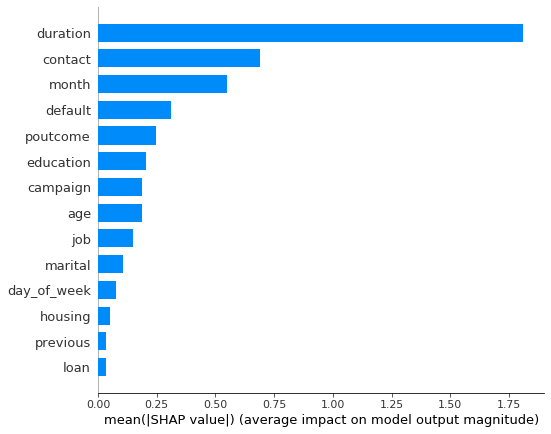

In [192]:
shap.summary_plot(shap_values, cat_X_train, plot_type="bar", class_names=['no','yes'])

<BarContainer object of 14 artists>

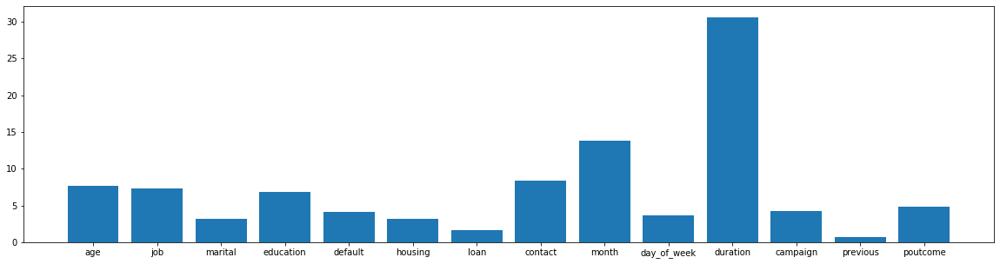

In [183]:
plt.figure(figsize=[20,5])
plt.bar(best_cbc.feature_names_, height= best_cbc.get_feature_importance())
#best_cbc.get_feature_importance()
#best_cbc.feature_names_

In [187]:
shap.dependence_plot('age', shap_values, cat_X_train)

ValueError: could not convert string to float: 'student'

In [189]:
cat_X_train
shap_values

array([[-0.12646529, -0.30272136, -0.11888006, ..., -0.12026396,
        -0.02612469, -0.20938516],
       [ 0.30694255, -0.18264457, -0.12273781, ...,  0.18263268,
        -0.02750736, -0.18533639],
       [ 0.45236274,  0.325001  ,  0.22735954, ...,  0.17370111,
        -0.00058539, -0.07831616],
       ...,
       [-0.13269471, -0.13439393,  0.25172362, ...,  0.27818322,
        -0.00681677, -0.15425868],
       [-0.18259797, -0.1420982 , -0.02268822, ...,  0.30485455,
        -0.02456761, -0.18004777],
       [ 0.25716025, -0.00421644,  0.25254232, ..., -0.42505813,
        -0.01617961, -0.19655517]])

In [190]:
shap_values.shape

(22049, 14)

In [191]:
train_labels

28210     no
24113     no
30895     no
13308     no
10302     no
        ... 
28629     no
5282     yes
19962    yes
26055     no
26801     no
Name: y, Length: 10861, dtype: object

In [193]:
pwd

'/Users/apple/.Trash/PERSONAL/companies/Adidas'

In [194]:
!ls

Adidas Data Science interview Case EDA.html
Adidas Data Science interview Case EDA.ipynb
Adidas Data Science interview Case ML Models.html
Adidas Data Science interview Case ML Models.ipynb
Adidas_Case_Study_v1.pptx
Adidas_app · Streamlit.mhtml
Adidas_app.py
Case Study- 2.ipynb
Case Study- 3-keras tuner.ipynb
Case Study- 3.ipynb
Case Study.ipynb
Cover_letter.docx
Data_adidas_case_study (1)
Data_adidas_case_study (1).zip
Untitled.ipynb
adidas_DS_Interview_forecast use case (3).pptx
adidas_image.png
catboost.pkl
catboost1.pkl
catboost_info
cb_model.json
my_dir
my_dir_tune
reduced_df.csv
reduced_df_model.pkl
